In [1]:
%load_ext autoreload
%autoreload 2

### Using diffusers

In [2]:
!which python

/raid/home/detectionfeuxdeforet/caillaud_gab/mva_pgm/MVA_PGM_NotMIWAE/pgm_venv/bin/python


In [3]:
import torch

from diffusers import ConsistencyModelPipeline
device = "cuda"

In [24]:

# Load the cd_imagenet64_l2 checkpoint.
model_id_or_path = "openai/diffusers-cd_imagenet64_l2"
pipe = ConsistencyModelPipeline.from_pretrained(model_id_or_path, torch_dtype=torch.float16)
pipe.to(device)


Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]

ConsistencyModelPipeline {
  "_class_name": "ConsistencyModelPipeline",
  "_diffusers_version": "0.32.2",
  "_name_or_path": "openai/diffusers-cd_imagenet64_l2",
  "scheduler": [
    "diffusers",
    "CMStochasticIterativeScheduler"
  ],
  "unet": [
    "diffusers",
    "UNet2DModel"
  ]
}

## Inpainting with LSUN bedrooms dataset

In [4]:
pipe_bedroom = ConsistencyModelPipeline.from_pretrained("openai/diffusers-cd_bedroom256_lpips")

Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]

An error occurred while trying to fetch /raid/home/detectionfeuxdeforet/caillaud_gab/.cache/huggingface/hub/models--openai--diffusers-cd_bedroom256_lpips/snapshots/563e73f9d0efe4841b9e303f1761de90dfad2d77/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /raid/home/detectionfeuxdeforet/caillaud_gab/.cache/huggingface/hub/models--openai--diffusers-cd_bedroom256_lpips/snapshots/563e73f9d0efe4841b9e303f1761de90dfad2d77/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


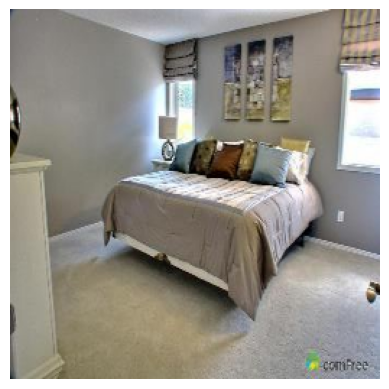

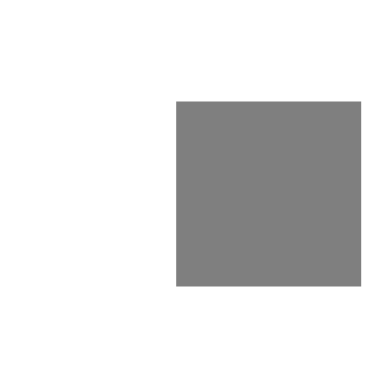

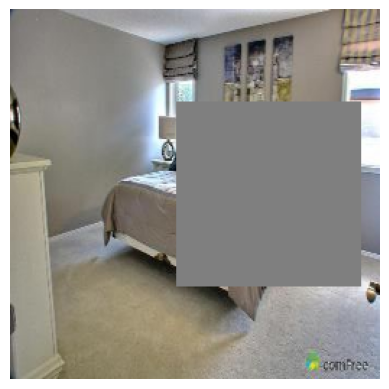

In [12]:
from consistency_inpainting import display_as_pilimg, create_square_mask, pilimg_to_tensor
from PIL import Image
x_true_pil = Image.open(f'LSUN_bedroom_sample.jpg').resize((256, 256))
x_true = pilimg_to_tensor(x_true_pil).to(device) 
res = display_as_pilimg(x_true)

mask_bed = create_square_mask(x_true.shape[-1])
res = display_as_pilimg(x_true*mask_bed)

  0%|          | 0/2 [00:00<?, ?it/s]

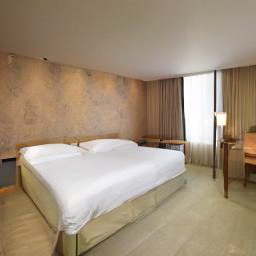

In [6]:
# Testing regular sampling
image = pipe_bedroom(num_inference_steps=None, timesteps=[20, 0]).images[0]
display(image)

In [189]:
# how many parameters?
sum(p.numel() for p in pipe_bedroom.unet.parameters())

526304771

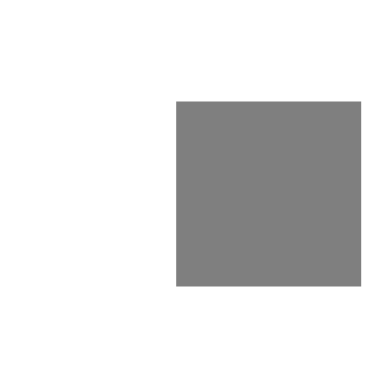

s_in=tensor([1.], device='cuda:0')
Timestep T=40


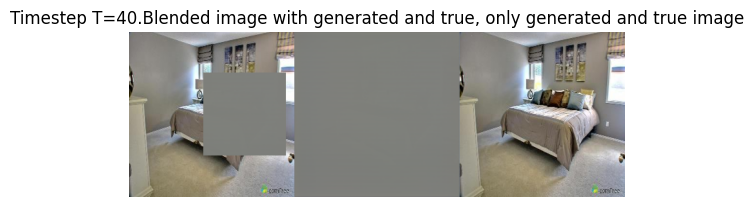

Timestep T=39


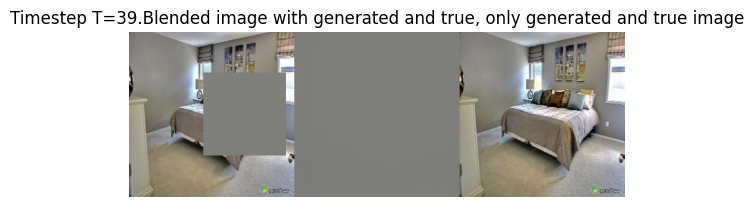

Timestep T=38


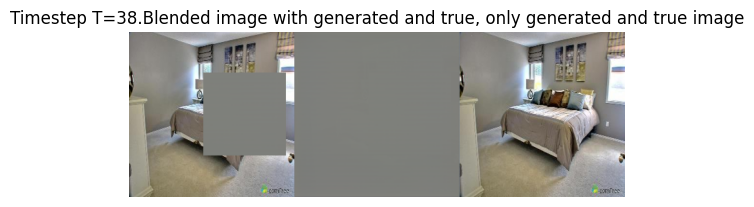

Timestep T=37


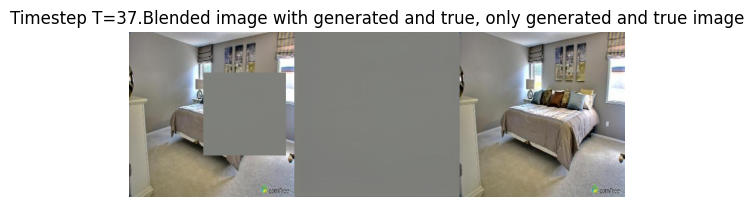

Timestep T=36


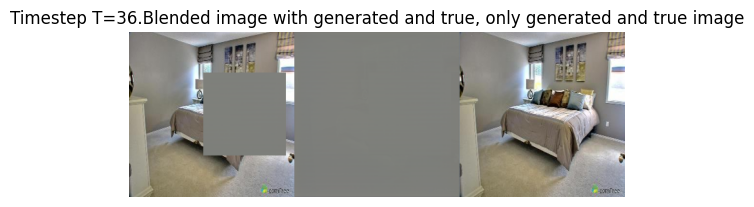

Timestep T=35


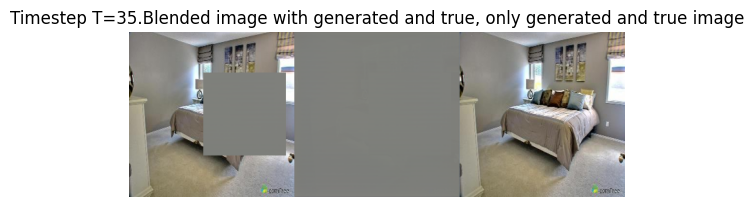

Timestep T=34


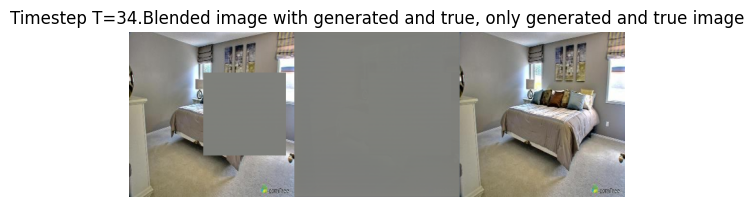

Timestep T=33


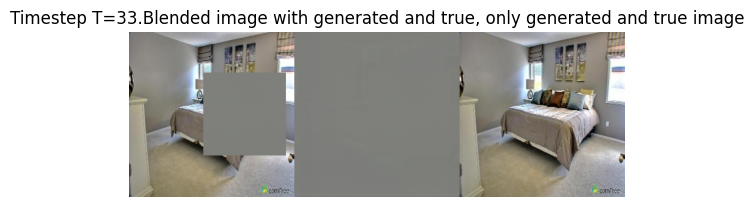

Timestep T=32


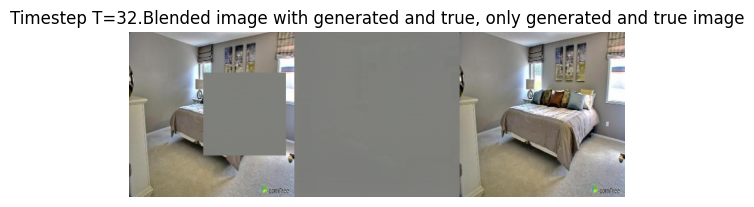

Timestep T=31


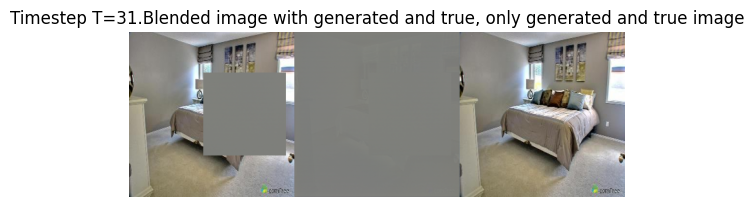

Timestep T=30


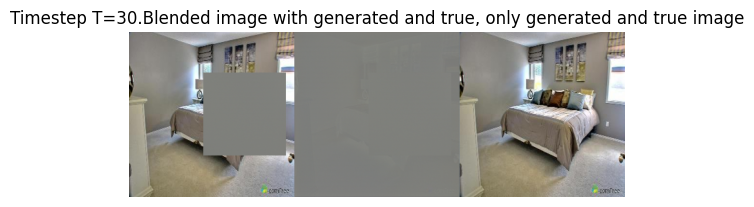

Timestep T=29


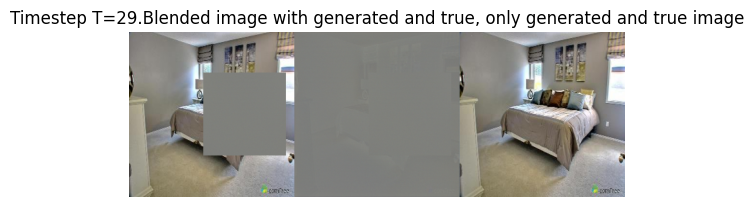

Timestep T=28


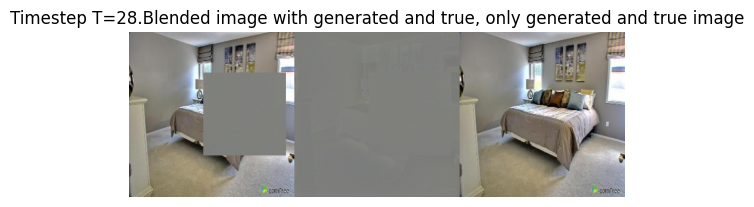

Timestep T=27


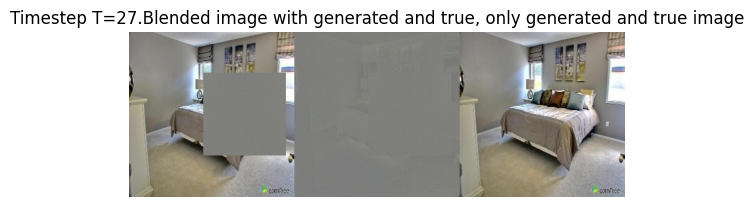

Timestep T=26


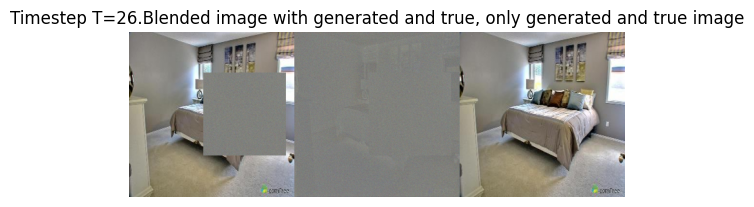

Timestep T=25


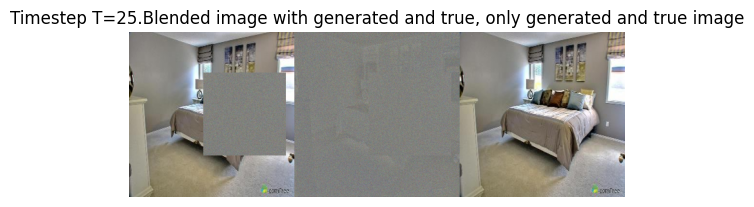

Timestep T=24


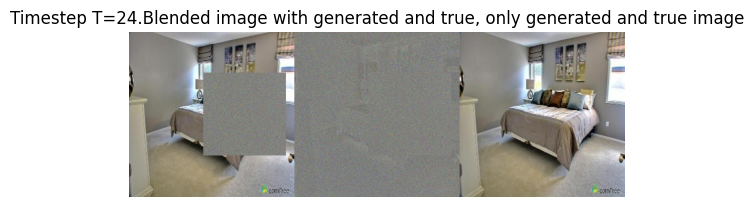

Timestep T=23


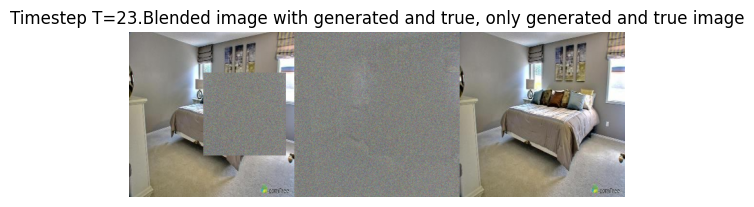

Timestep T=22


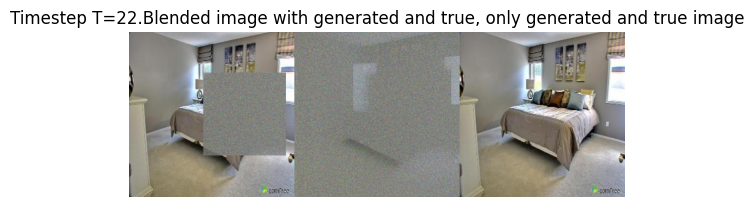

Timestep T=21


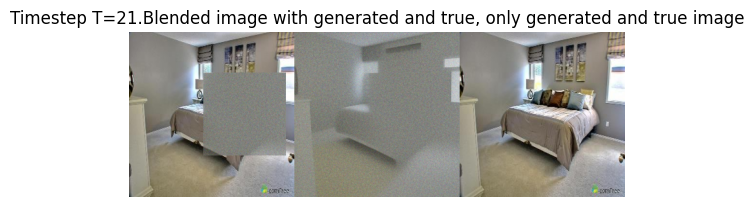

Timestep T=20


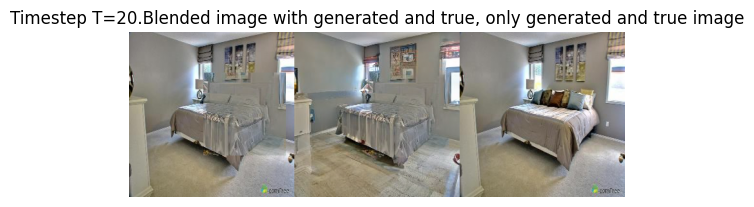

Timestep T=19


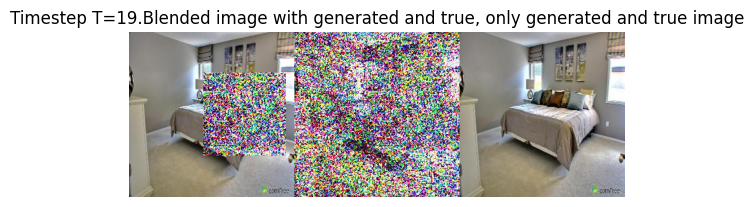

Timestep T=18


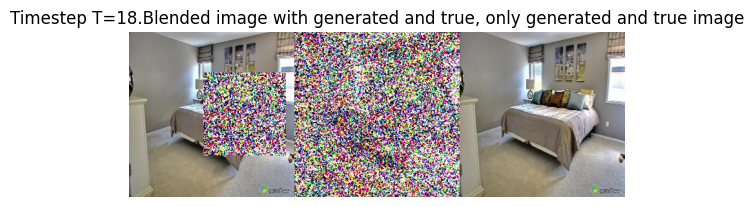

Timestep T=17


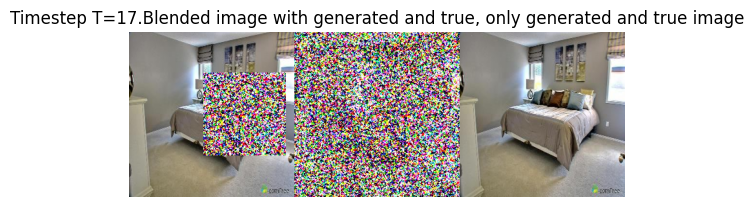

Timestep T=16


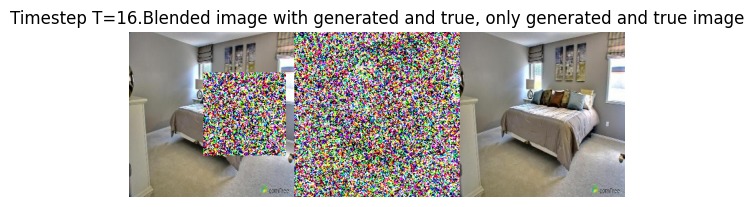

Timestep T=15


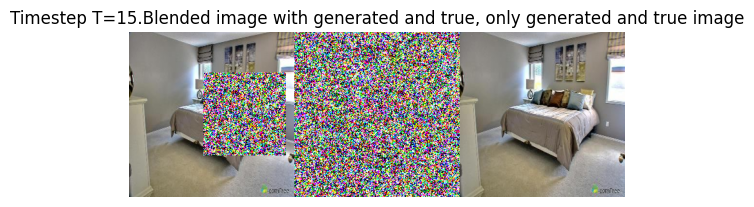

Timestep T=14


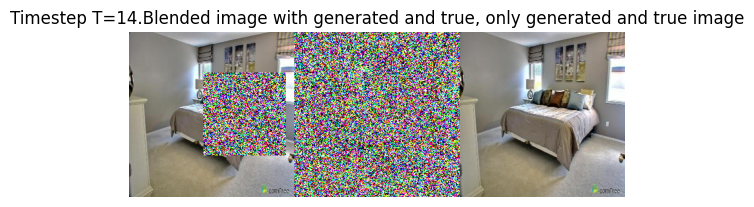

Timestep T=13


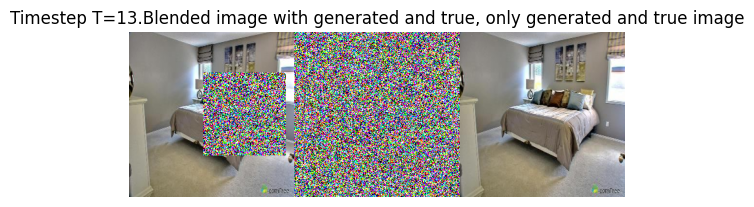

Timestep T=12


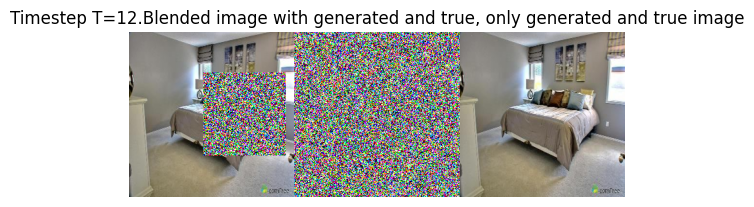

Timestep T=11


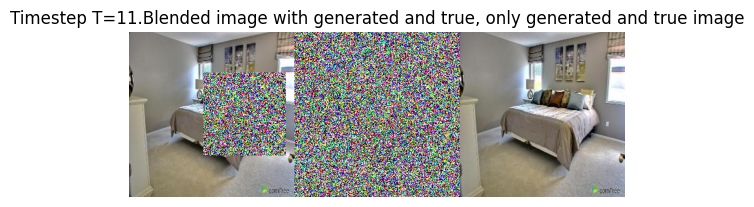

Timestep T=10


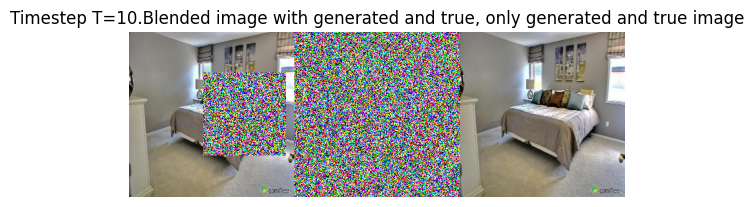

Timestep T=9


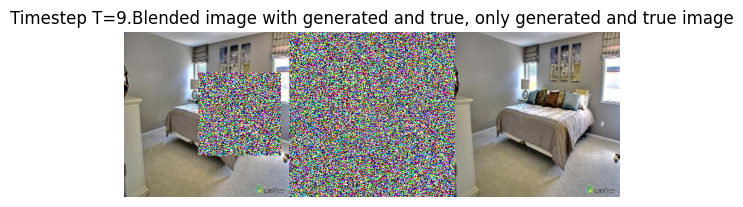

Timestep T=8


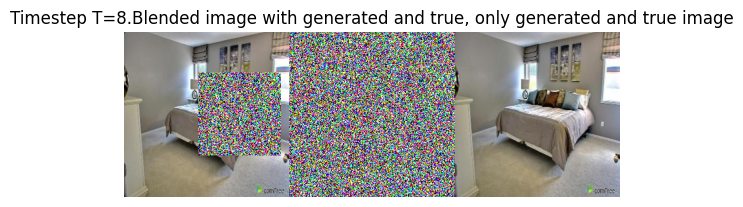

Timestep T=7


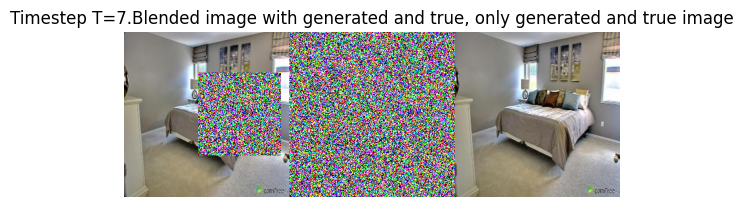

Timestep T=6


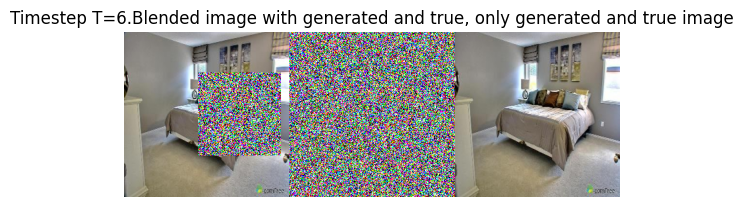

Timestep T=5


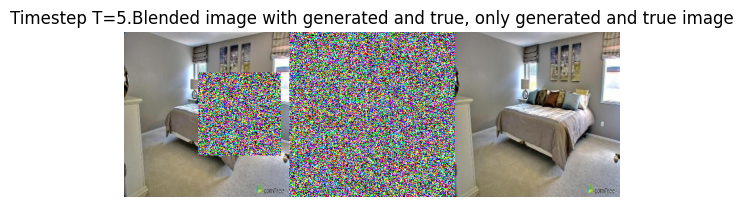

Timestep T=4


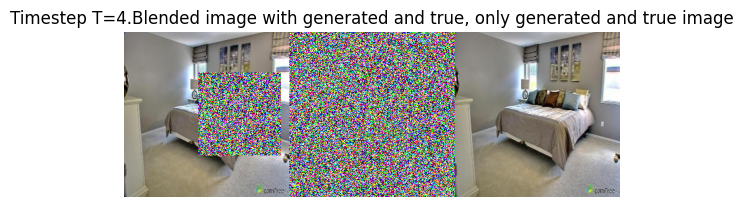

Timestep T=3


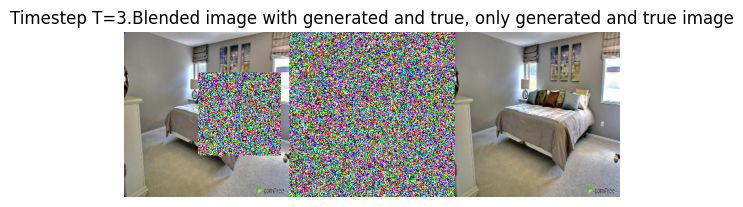

Timestep T=2


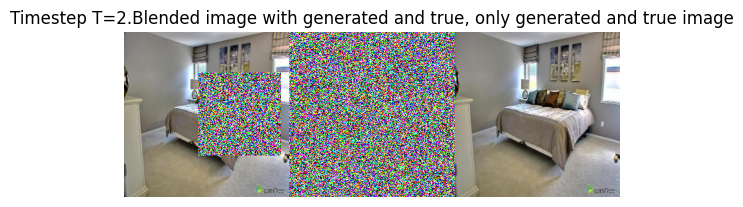

In [23]:
from consistency_inpainting import iterative_inpainting
pipe_bedroom.to(device)
x_true.to(device)
x, images = iterative_inpainting(
    pipe_bedroom,
    images=x_true,
    x=x_true.clone(),
    ts=[i for i in range(40,0,-1)], use_square_mask=True, show_all_modified_image=True)

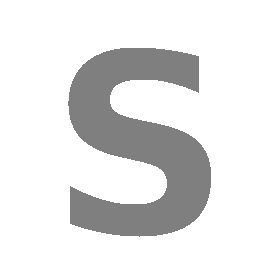

mask.shape=torch.Size([256, 256])
s_in=tensor([1.], device='cuda:0')
Timestep T=40
4


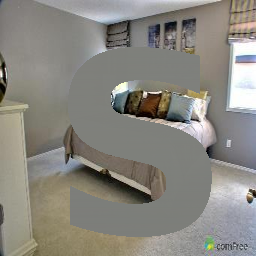

Timestep T=39
4


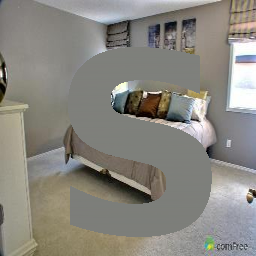

Timestep T=38
4


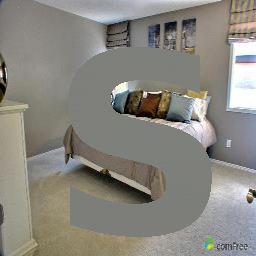

Timestep T=37
4


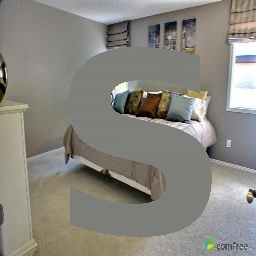

Timestep T=36
4


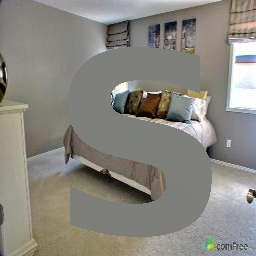

Timestep T=35
4


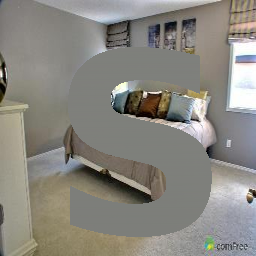

Timestep T=34
4


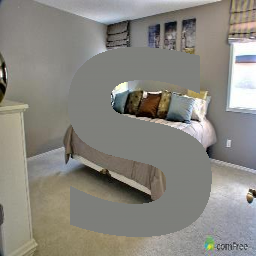

Timestep T=33
4


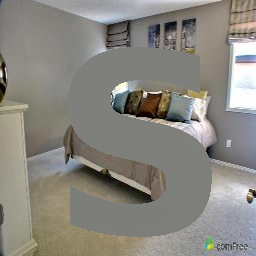

Timestep T=32
4


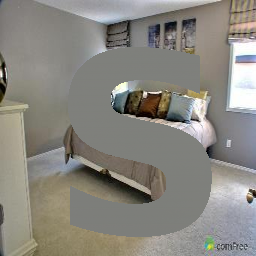

Timestep T=31
4


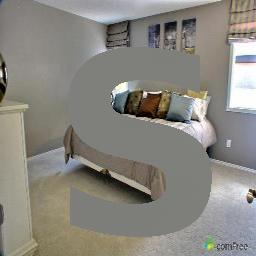

Timestep T=30
4


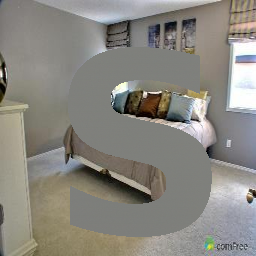

Timestep T=29
4


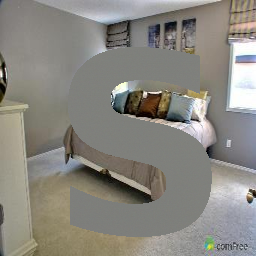

Timestep T=28
4


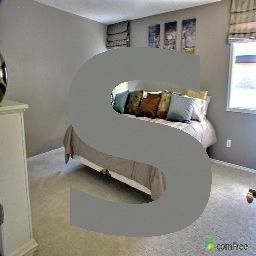

Timestep T=27
4


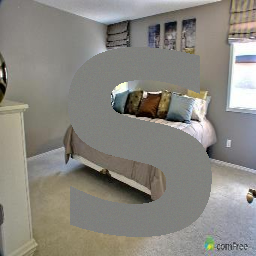

Timestep T=26
4


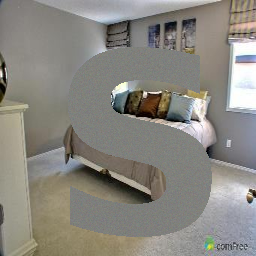

Timestep T=25
4


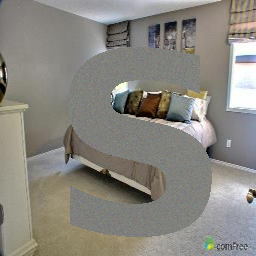

Timestep T=24
4


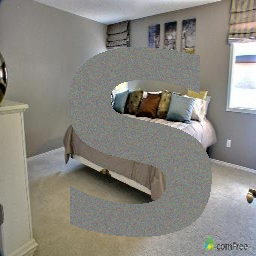

Timestep T=23
4


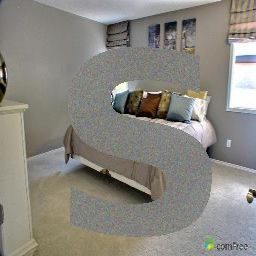

Timestep T=22
4


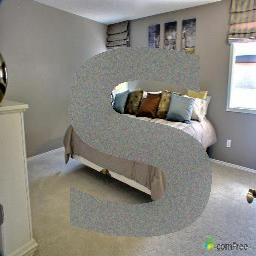

Timestep T=21
4


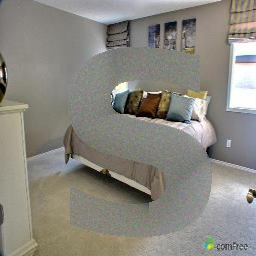

Timestep T=20
4


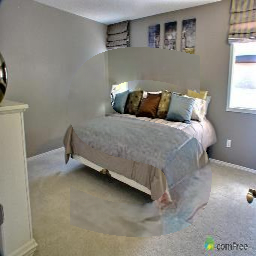

Timestep T=19
4


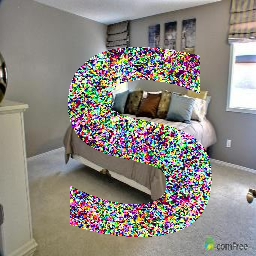

Timestep T=18
4


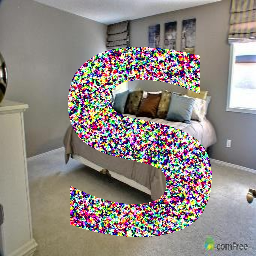

Timestep T=17
4


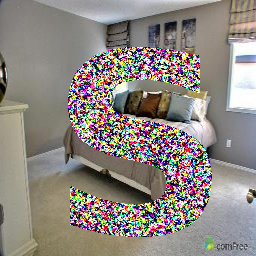

Timestep T=16
4


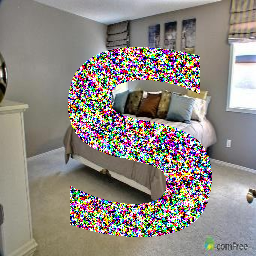

Timestep T=15
4


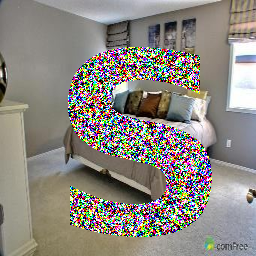

Timestep T=14
4


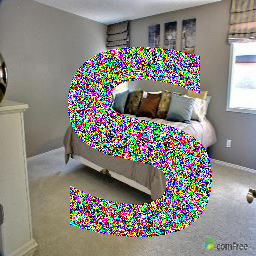

Timestep T=13
4


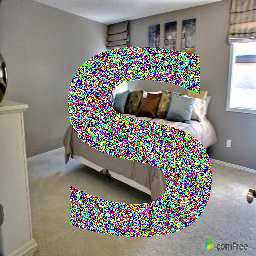

Timestep T=12
4


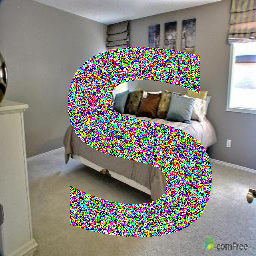

Timestep T=11
4


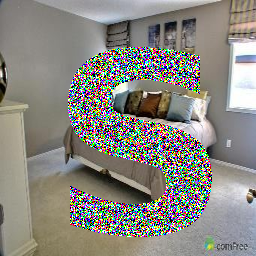

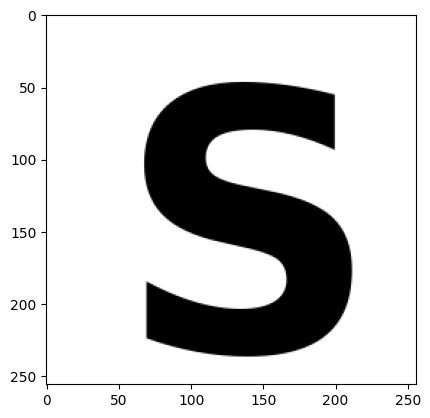

In [344]:
x, images = iterative_inpainting(
    pipe_bedroom.unet,
    images=x_true,
    x=x_true.clone(),
    ts=[i for i in range(40,9,-1)])

s_in=tensor([1.], device='cuda:0')
Timestep T=40
4


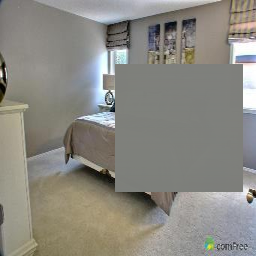

Timestep T=39
4


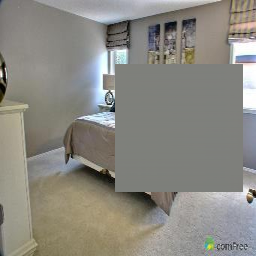

Timestep T=38
4


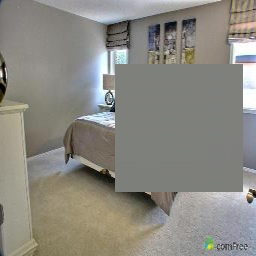

Timestep T=37
4


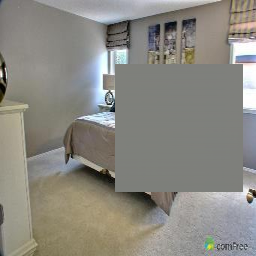

Timestep T=36
4


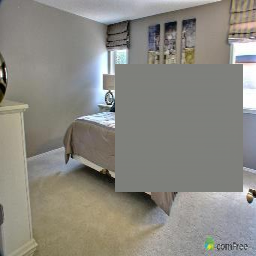

Timestep T=35
4


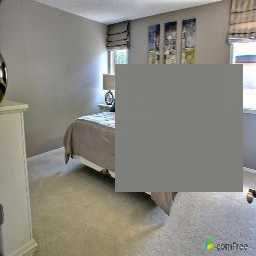

Timestep T=34
4


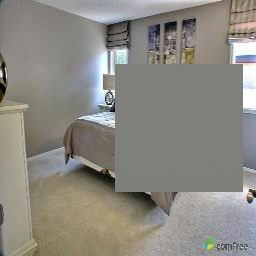

Timestep T=33
4


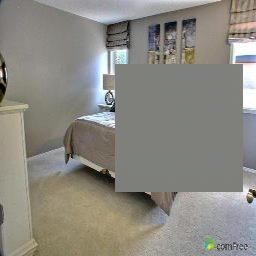

Timestep T=32
4


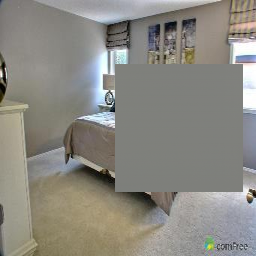

Timestep T=31
4


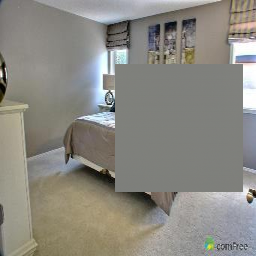

Timestep T=30
4


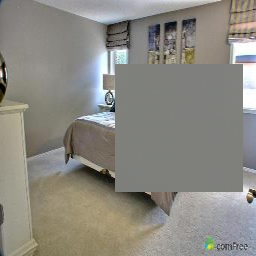

Timestep T=29
4


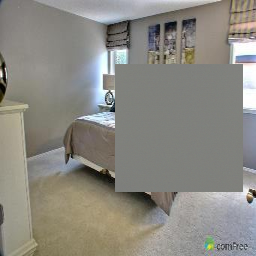

Timestep T=28
4


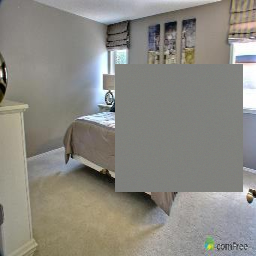

Timestep T=27
4


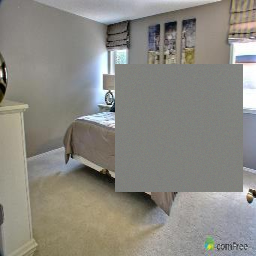

Timestep T=26
4


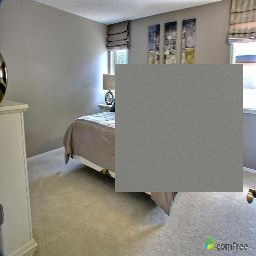

Timestep T=25
4


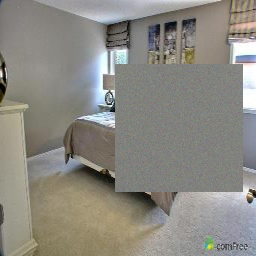

Timestep T=24
4


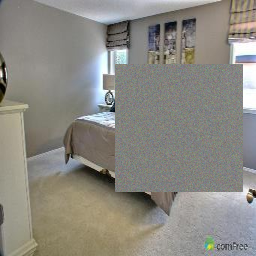

Timestep T=23
4


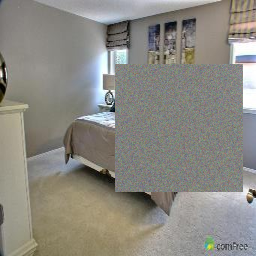

Timestep T=22
4


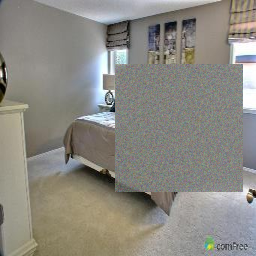

Timestep T=21
4


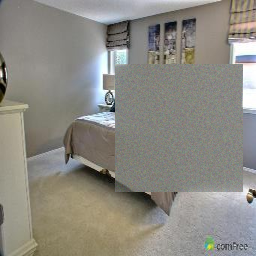

Timestep T=20
4


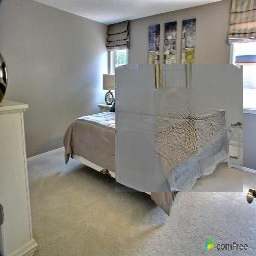

Timestep T=19
4


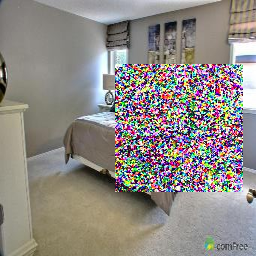

Timestep T=18
4


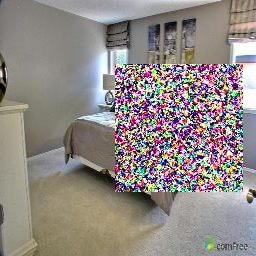

Timestep T=17
4


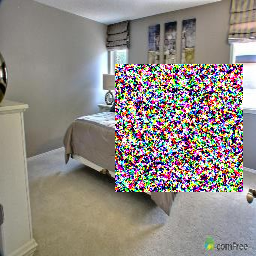

Timestep T=16
4


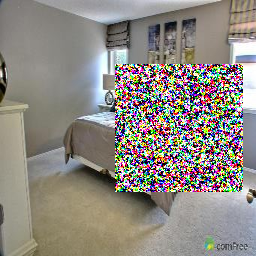

Timestep T=15
4


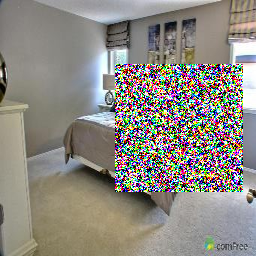

Timestep T=14
4


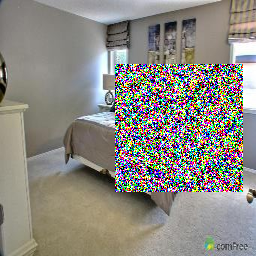

Timestep T=13
4


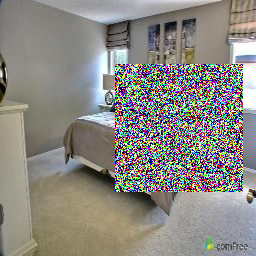

Timestep T=12
4


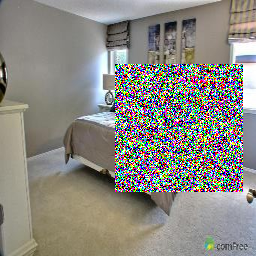

Timestep T=11
4


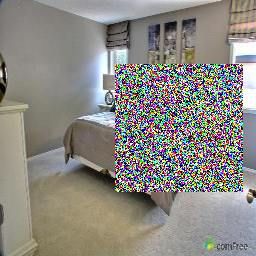

Timestep T=10
4


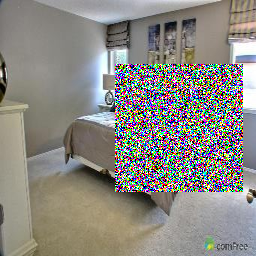

Timestep T=9
4


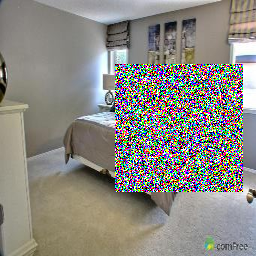

Timestep T=8
4


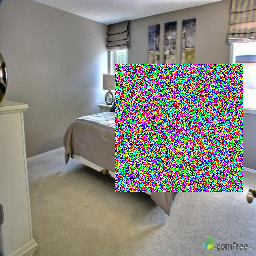

Timestep T=7
4


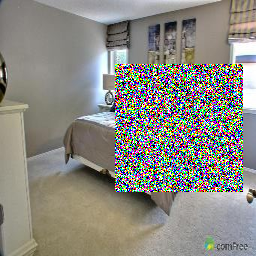

Timestep T=6
4


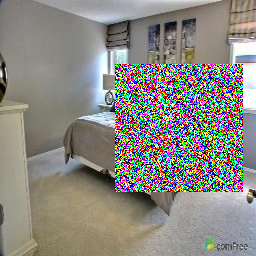

Timestep T=5
4


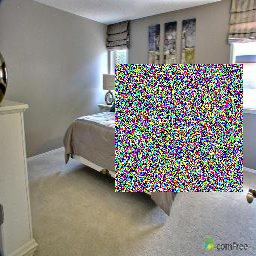

Timestep T=4
4


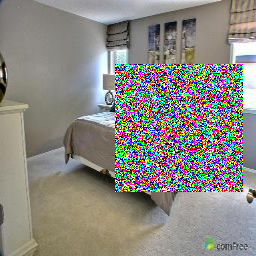

Timestep T=3
4


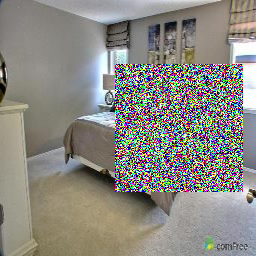

In [359]:
x, images = iterative_inpainting(
    pipe_bedroom.unet,
    images=x_true,
    x=x_true.clone(),
    ts=[i for i in range(40,1,-1)], use_square_mask=True)

# Try on ImageNet

In [2]:
%load_ext autoreload
%autoreload 2

Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]

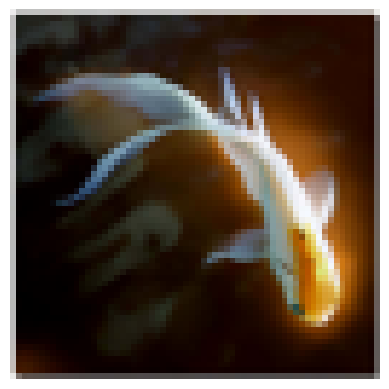

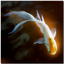

In [6]:
from consistency_inpainting import create_square_mask,iterative_inpainting, pilimg_to_tensor, display_as_pilimg
from PIL import Image
from diffusers import ConsistencyModelPipeline
import torch
device = "cuda" if torch.cuda.is_available() else "cpu"
# Load the cd_imagenet64_l2 checkpoint.
model_id_or_path = "openai/diffusers-cd_imagenet64_l2"
pipe = ConsistencyModelPipeline.from_pretrained(model_id_or_path, torch_dtype=torch.float16)
pipe.to(device)

x_true_pil = Image.open(f'imagenet_sample_class1.JPEG').resize((64, 64))  # Resize to 64x64
x_true = pilimg_to_tensor(x_true_pil).to(device) 
display_as_pilimg(x_true)

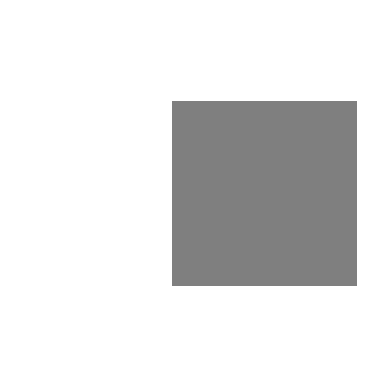

s_in=tensor([1.], device='cuda:0')
Timestep T=40


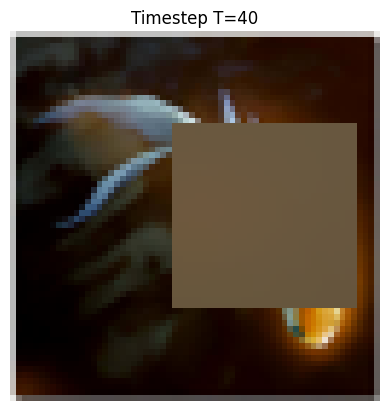

Timestep T=39


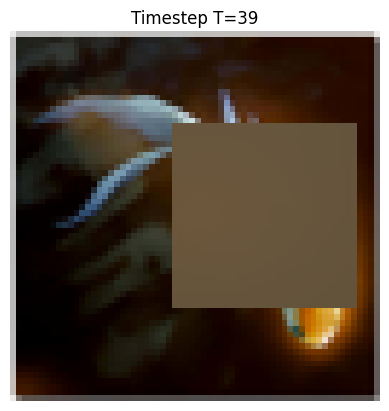

Timestep T=38


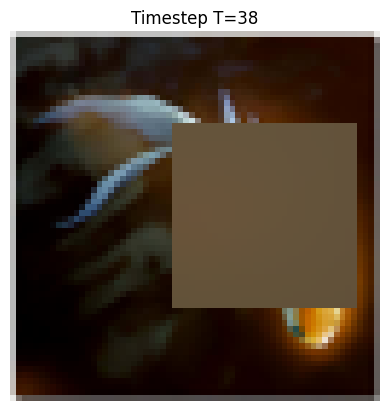

Timestep T=37


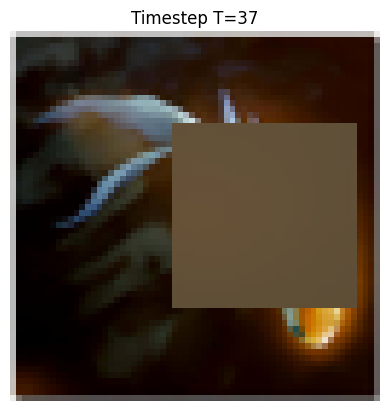

Timestep T=36


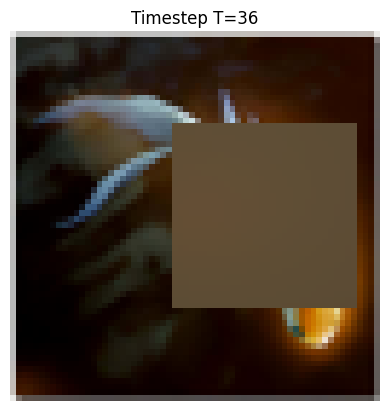

Timestep T=35


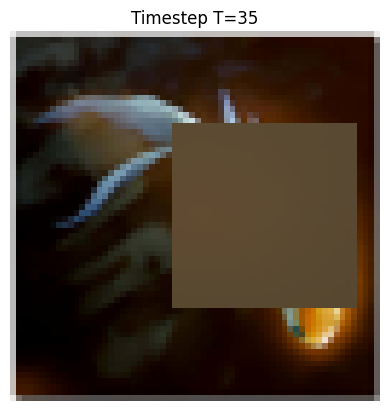

Timestep T=34


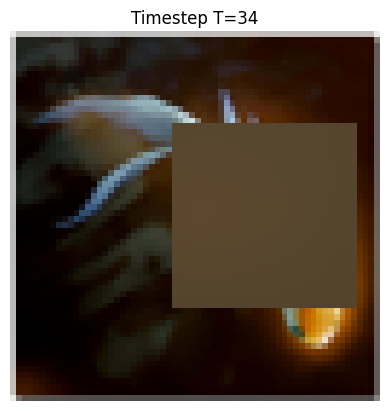

Timestep T=33


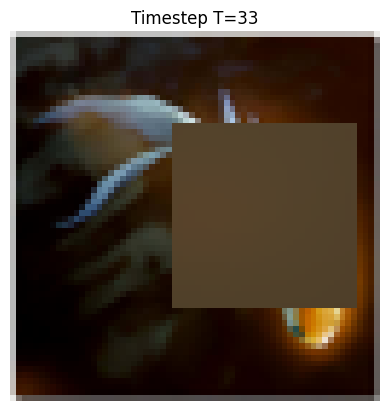

Timestep T=32


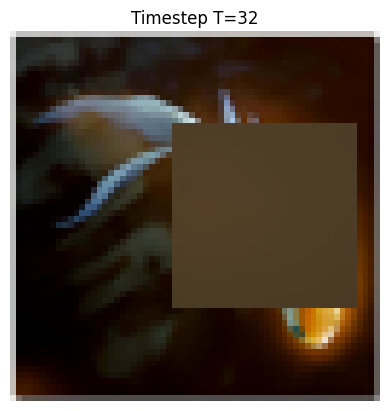

Timestep T=31


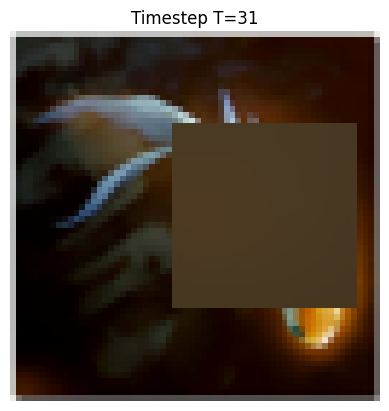

Timestep T=30


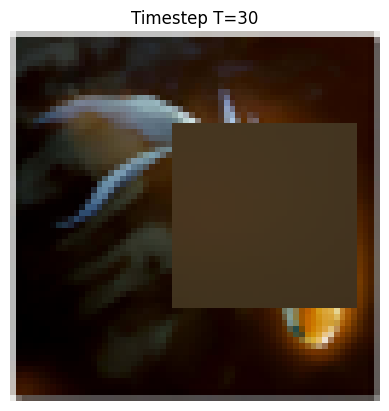

Timestep T=29


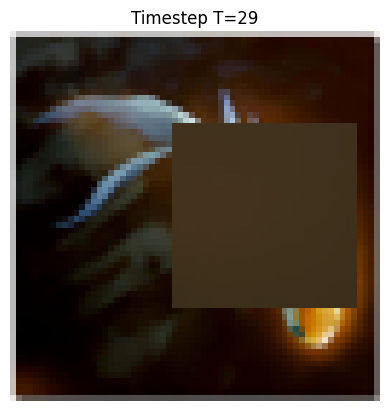

Timestep T=28


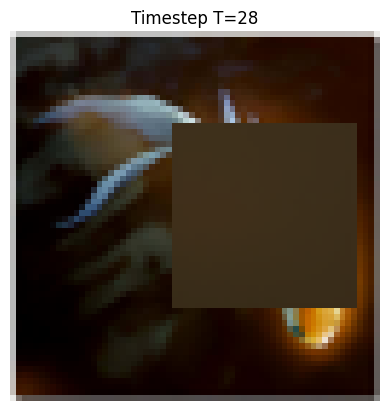

Timestep T=27


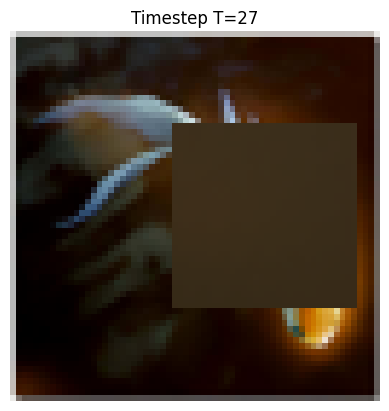

Timestep T=26


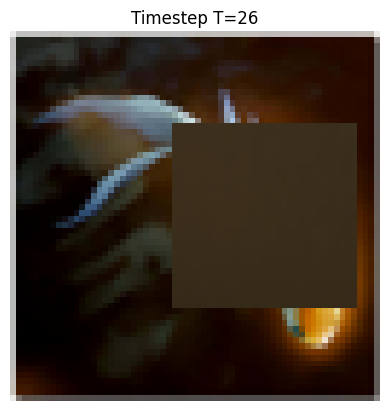

Timestep T=25


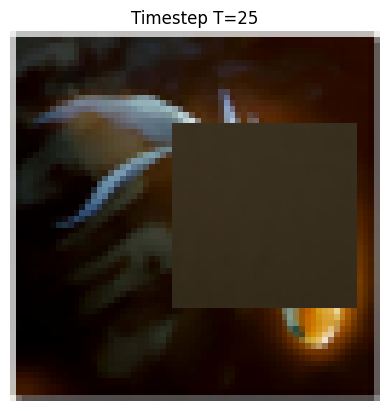

Timestep T=24


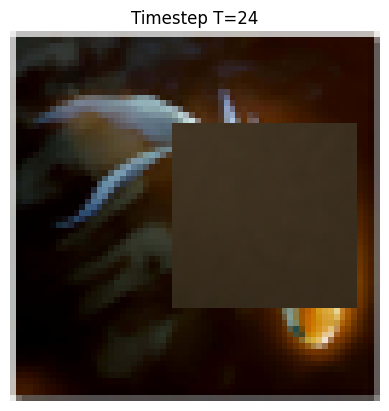

Timestep T=23


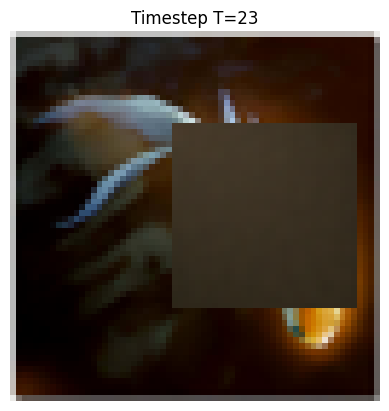

Timestep T=22


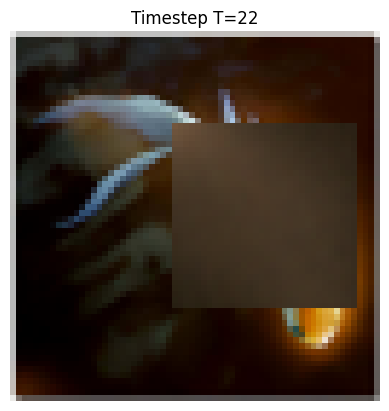

Timestep T=21


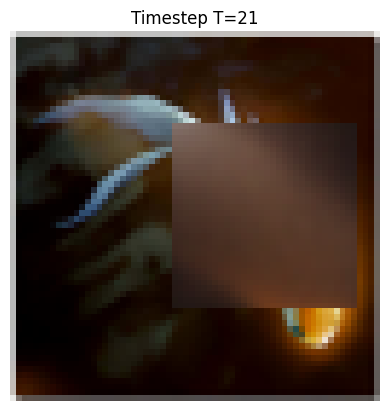

Timestep T=20


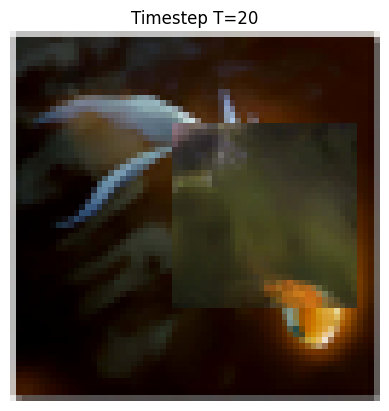

Timestep T=19


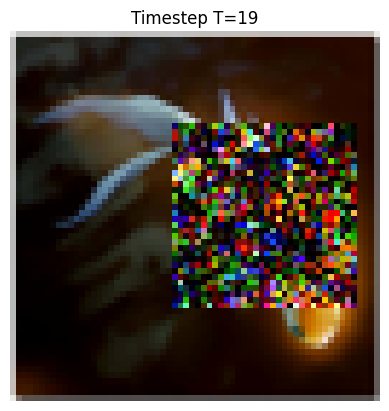

Timestep T=18


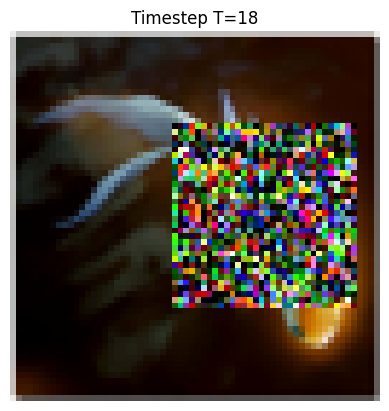

Timestep T=17


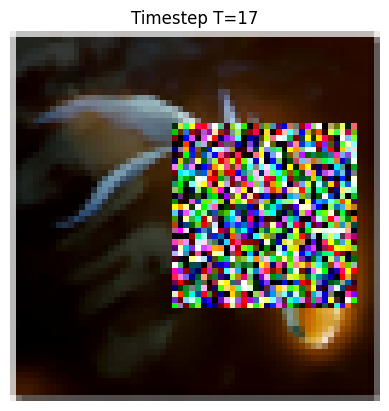

Timestep T=16


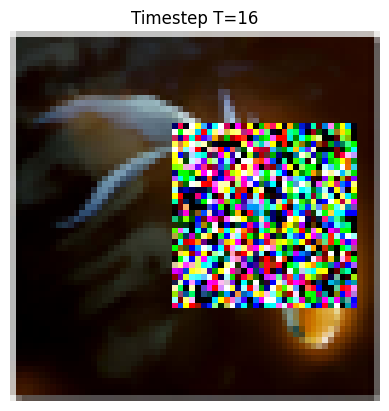

Timestep T=15


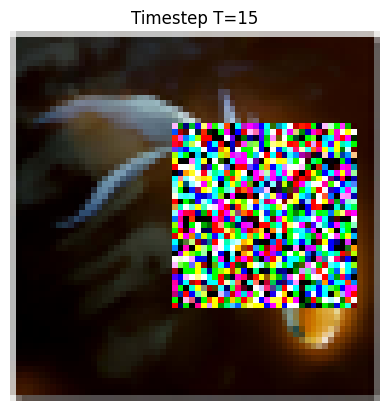

Timestep T=14


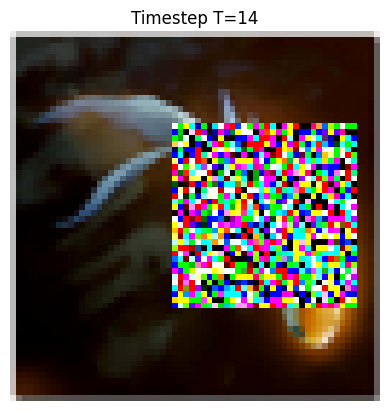

Timestep T=13


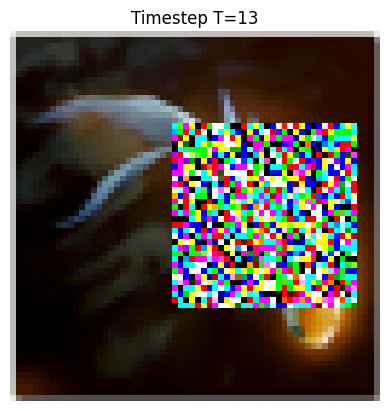

Timestep T=12


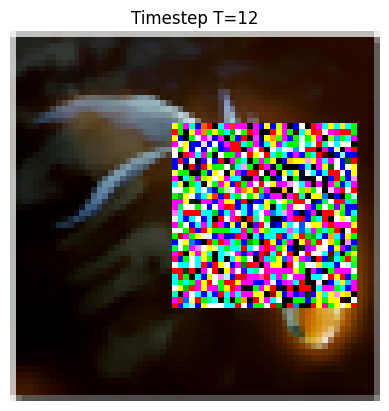

Timestep T=11


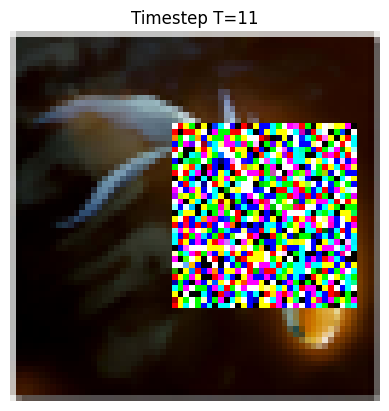

Timestep T=10


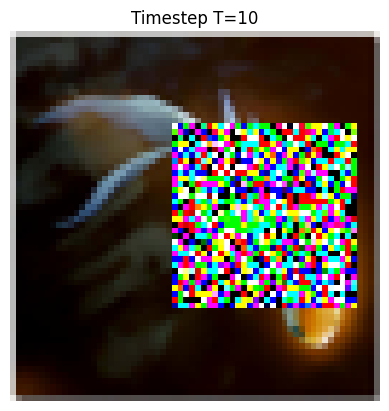

Timestep T=9


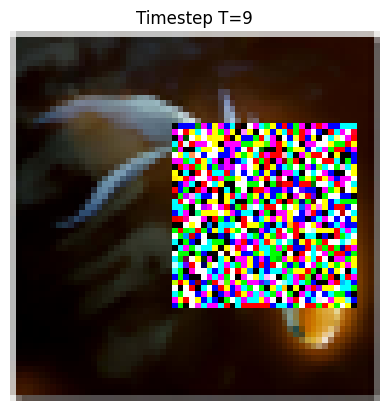

Timestep T=8


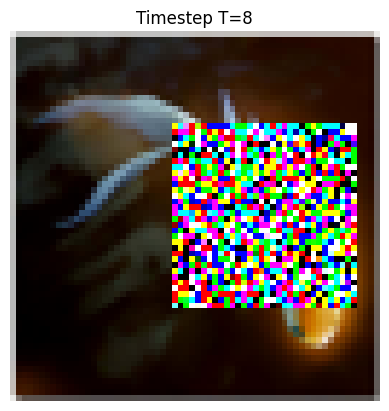

Timestep T=7


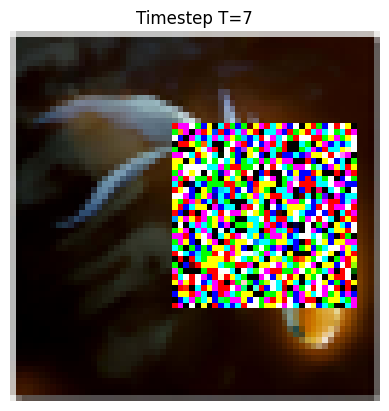

Timestep T=6


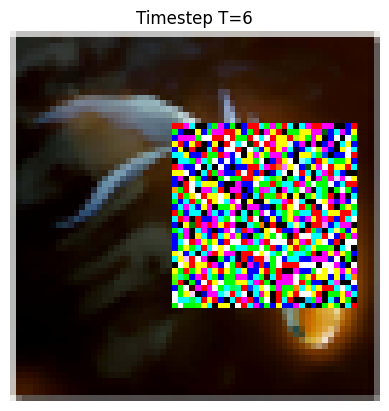

Timestep T=5


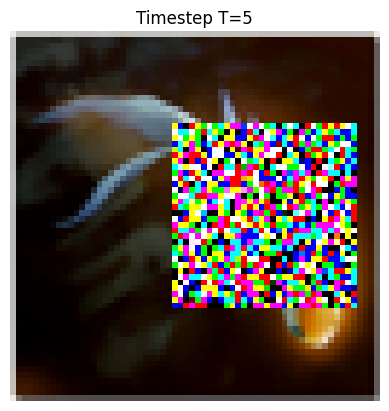

Timestep T=4


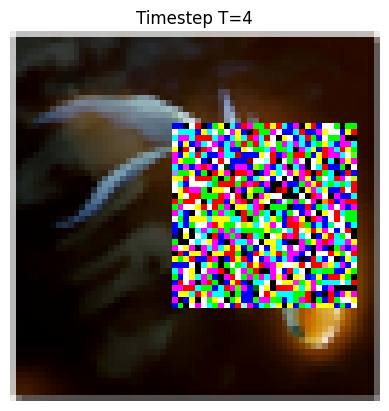

Timestep T=3


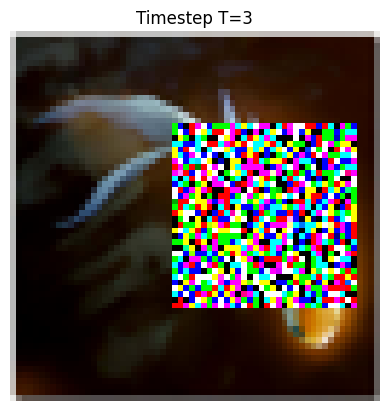

Timestep T=2


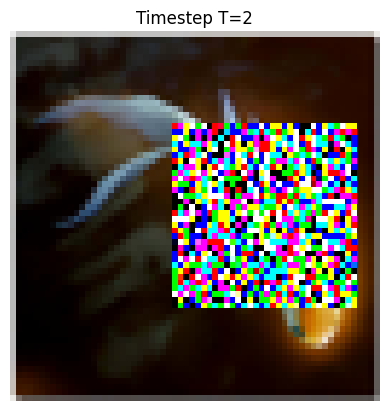

(tensor([[[[ 138.0125,  -32.1678, -122.4167,  ..., -146.0033,  -95.8213,
             115.2308],
           [ -13.0343,   53.8398,   29.6504,  ...,  -11.7492,  -10.8725,
             -15.2458],
           [ -62.8004,    4.9691,   54.8672,  ...,  -55.5766,   48.4263,
             114.3342],
           ...,
           [ -78.1675, -107.9773,  -40.1074,  ...,  -81.8773,    4.0834,
              -5.2588],
           [ 120.8454,    3.5816,   61.3616,  ...,   36.8402,   70.3800,
            -127.8968],
           [ 121.4498,   70.2851,  -12.9896,  ...,  -65.3246,   44.1876,
             -55.1670]],
 
          [[   9.8971,   65.8816,   40.7564,  ...,  170.2223,  109.3109,
              38.0585],
           [  54.5520,    8.6556,  120.1639,  ...,  -16.7432,   36.4501,
              13.6058],
           [-137.6290,  -71.2944,   17.2650,  ...,   43.7797,   33.4666,
             -82.2790],
           ...,
           [  38.2147,  -12.0765,   38.0612,  ...,  -38.8533,  -13.5879,
              17.28

In [ ]:
from consistency_inpainting import create_square_mask,iterative_inpainting
iterative_inpainting(pipe=pipe, images=x_true,class_labels=1, is_imagenet=True,
    x=x_true.clone(),
    ts=[i for i in range(40,0,-1)], use_square_mask=True)


In [30]:
ts=np.arange(start=0,stop=80,step=2)
print(ts)

[ 0  2  4  6  8 10 12 14 16 18 20 22 24 26 28 30 32 34 36 38 40 42 44 46
 48 50 52 54 56 58 60 62 64 66 68 70 72 74 76 78]


ts=[10, 9, 8, 7, 6, 5, 4, 3, 2, 1, 0]


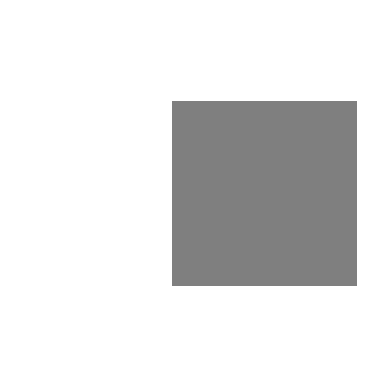

s_in=tensor([1.], device='cuda:0')
Timestep T=10


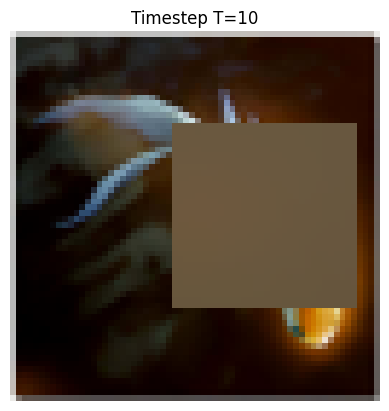

Timestep T=9


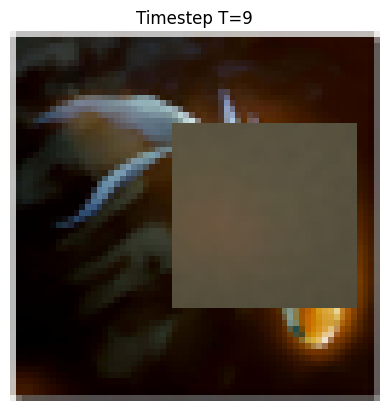

Timestep T=8


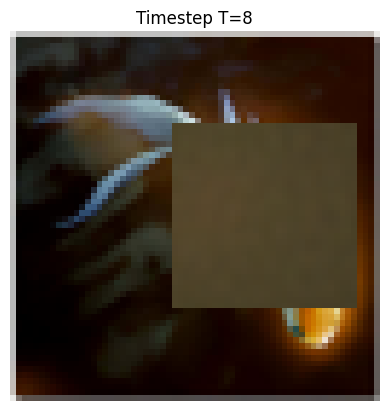

Timestep T=7


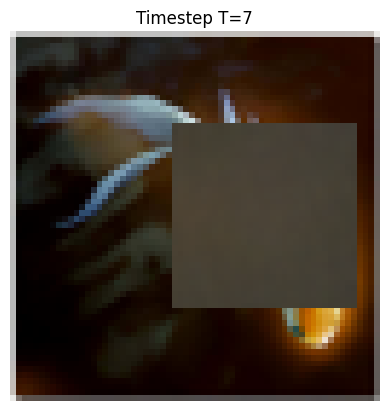

Timestep T=6


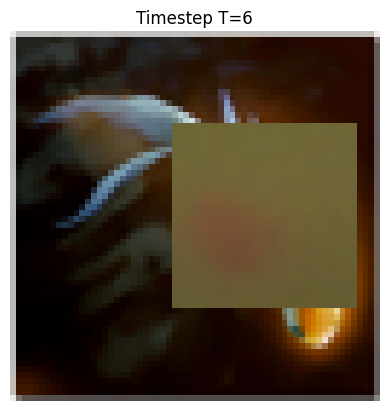

Timestep T=5


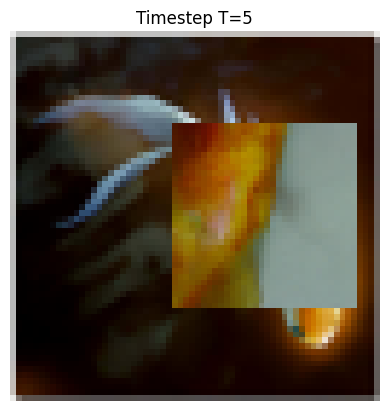

Timestep T=4


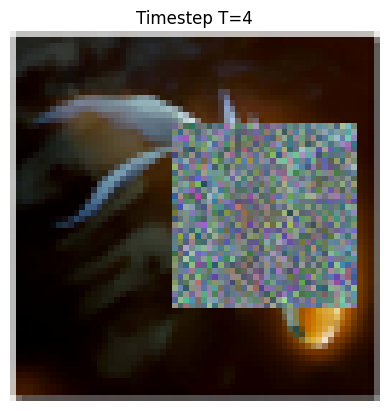

Timestep T=3


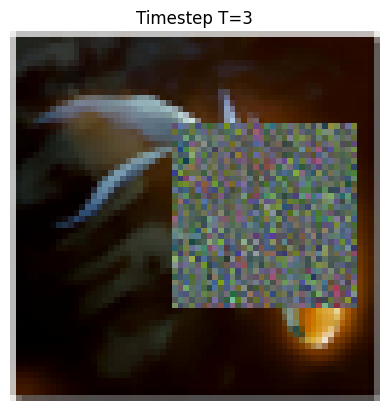

Timestep T=2


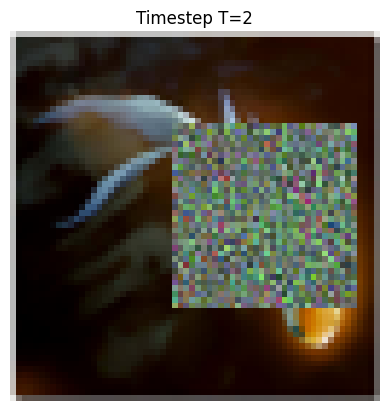

Timestep T=1


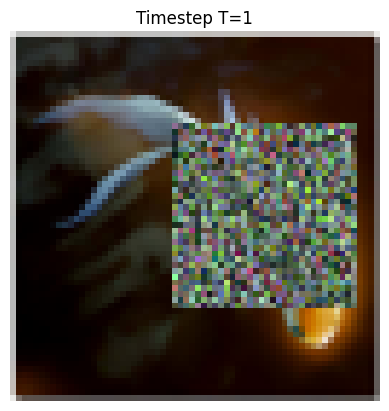

(tensor([[[[ 117.8712,  -86.1297,  -54.8530,  ...,   43.2628, -126.2877,
             -54.9148],
           [ 213.9696,  -29.8285,  -47.9682,  ...,   97.3620, -100.6754,
             -41.9276],
           [  47.1961,   25.0114,  107.3815,  ...,   -8.7090,  -27.2456,
            -118.0693],
           ...,
           [ -22.1931, -176.1364,  -38.0505,  ...,    2.3925,    2.2854,
             134.7465],
           [  40.2825,   79.2094,  -86.9404,  ...,  -27.6437,  135.9252,
             -81.9538],
           [ -36.3474,  -29.0389,    0.4781,  ..., -114.2471,    4.7416,
              27.8673]],
 
          [[ -88.3677,   98.9511,    7.1940,  ...,   37.4599,   -8.5803,
              47.3841],
           [ -28.0192,  -95.3513,  -18.0189,  ...,  -64.8121,   68.4277,
            -260.8511],
           [  69.4905,   50.0121,   32.7937,  ...,   89.9145,   97.1978,
             -38.5622],
           ...,
           [  71.0226,  -15.7751,  -47.8383,  ...,  -78.1057,   31.9353,
             -24.72

In [35]:
N = 40
import numpy as np
ts=np.arange(start=0,stop=80,step=2)[::-1]
ts = [i for i in range(10,-1,-1)]
print(f"{ts=}")
iterative_inpainting(pipe=pipe, images=x_true,class_labels=1, is_imagenet=True,
x=x_true.clone(),
ts=ts, use_square_mask=True)

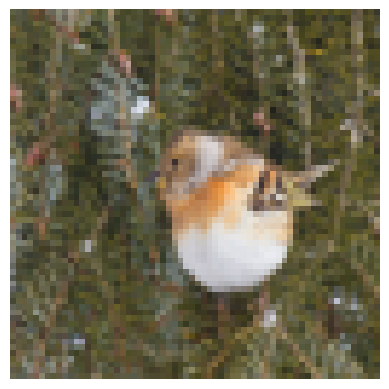

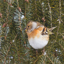

In [36]:
x_true_pil_class10 = Image.open(f'imagenet_sample_class10.JPEG').resize((64, 64))  # Resize to 64x64
x_true_class10 = pilimg_to_tensor(x_true_pil_class10).to(device) 
display_as_pilimg(x_true_class10)

ts=[10, 9, 8, 7, 6, 5, 4, 3, 2, 1]


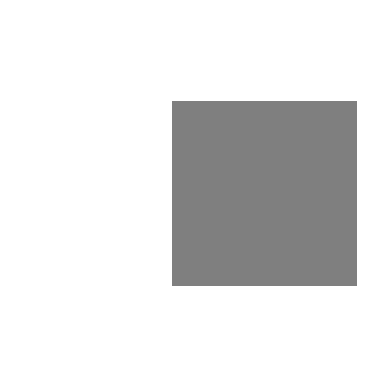

s_in=tensor([1.], device='cuda:0')
Timestep T=10


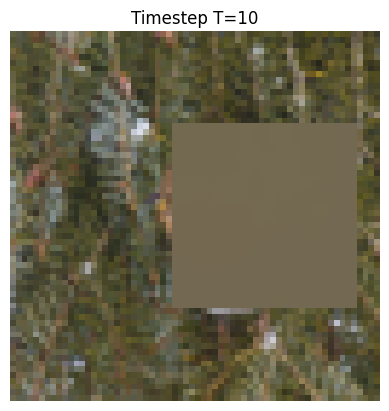

Timestep T=9


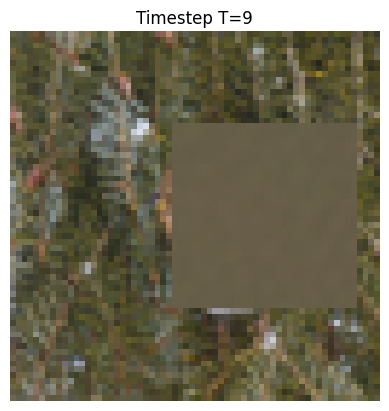

Timestep T=8


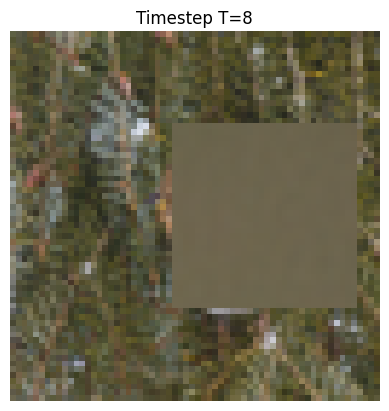

Timestep T=7


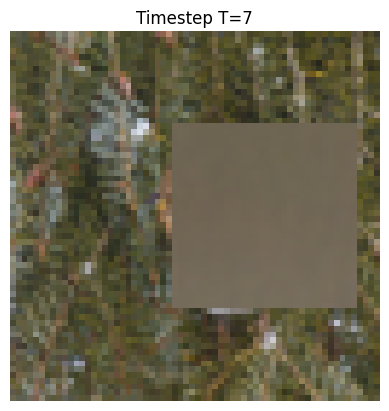

Timestep T=6


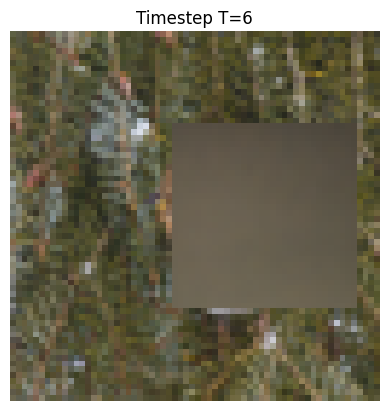

Timestep T=5


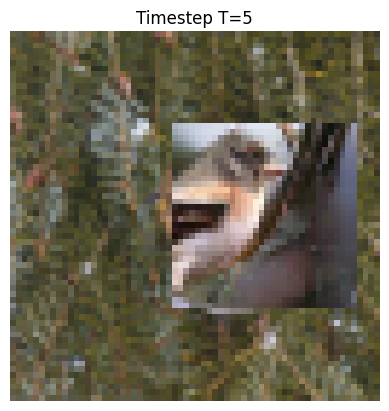

Timestep T=4


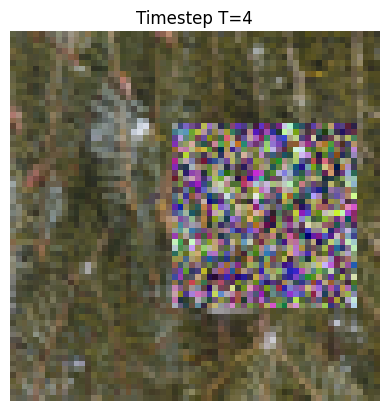

Timestep T=3


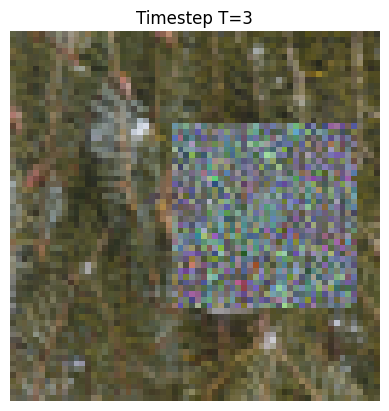

Timestep T=2


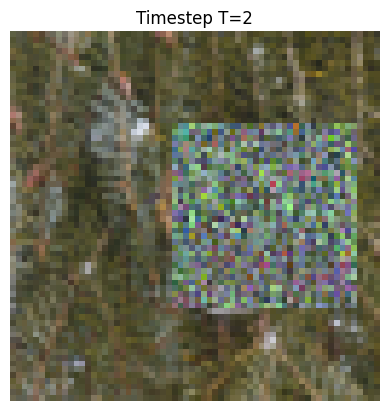

(tensor([[[[  93.8741,    9.7162, -114.0191,  ...,   69.6356,   -7.0876,
             -11.1185],
           [  84.7873,  -35.6785,  -24.6235,  ...,    5.7026, -102.8555,
             -27.2826],
           [  69.0483, -101.1814, -129.6344,  ...,  -32.8012, -100.6594,
             -47.2462],
           ...,
           [ -35.4852,   91.3955,   29.6899,  ..., -129.2217, -130.4512,
             -84.1621],
           [ -55.3450,  -74.1499,   20.1459,  ...,   10.2605,  -39.7912,
             -53.9233],
           [ -58.5355,   63.3778,  -22.7877,  ...,   39.9799,   72.4277,
              28.7747]],
 
          [[ -49.4177,   45.2926,  -60.6510,  ...,   47.3962,  157.9669,
             -35.3043],
           [  27.3108,   62.7941,    1.7788,  ...,   87.9584,  -21.3022,
              44.1750],
           [ -32.5886, -117.8846,   -8.5740,  ...,   -3.5529,  -62.6434,
              -5.7099],
           ...,
           [  93.1937,   -8.0477,   63.3316,  ...,   39.6064,  -17.5820,
              -3.08

In [39]:
ts = [i for i in range(10,0,-1)]
print(f"{ts=}")
iterative_inpainting(pipe=pipe, images=x_true_class10,class_labels=10, is_imagenet=True,
x=x_true_class10.clone(),
ts=ts, use_square_mask=True)

Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]

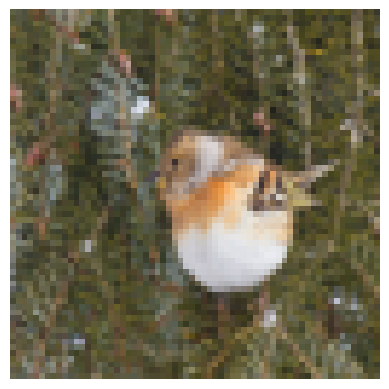

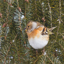

In [28]:
from consistency_inpainting import create_square_mask,iterative_inpainting, pilimg_to_tensor, display_as_pilimg
from PIL import Image
from diffusers import ConsistencyModelPipeline
import torch
device = "cuda" if torch.cuda.is_available() else "cpu"
# Load the cd_imagenet64_l2 checkpoint.
model_id_or_path = "openai/diffusers-cd_imagenet64_l2"
pipe = ConsistencyModelPipeline.from_pretrained(model_id_or_path)
pipe.to(device)

x_true_pil = Image.open(f'imagenet_sample_class10.JPEG').resize((64, 64))  # Resize to 64x64
x_true = pilimg_to_tensor(x_true_pil).to(device) 
display_as_pilimg(x_true)

ts=[10, 9, 8, 7, 6, 5, 4, 3, 2, 1]


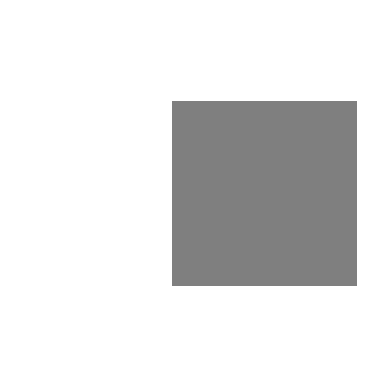

s_in=tensor([1.], device='cuda:0')
Timestep T=10


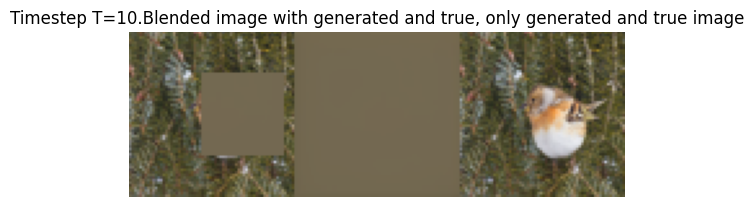

Timestep T=9


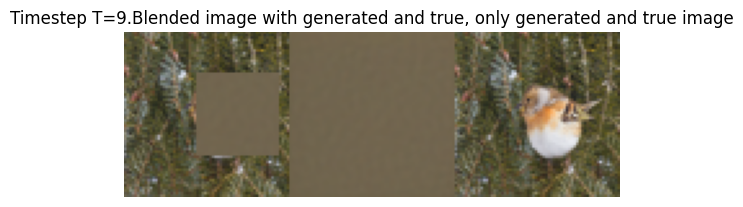

Timestep T=8


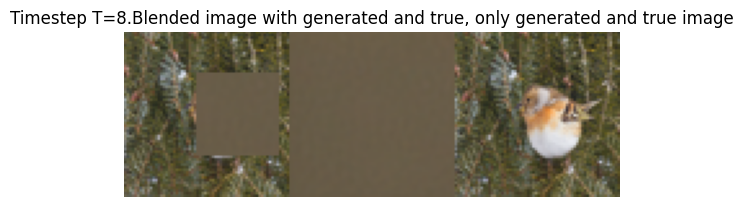

Timestep T=7


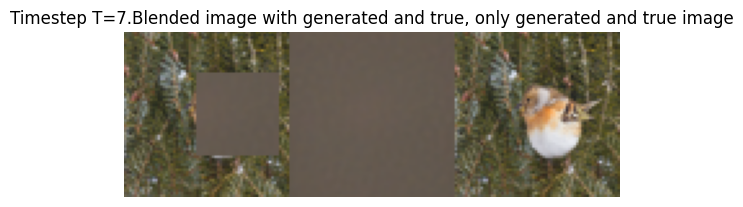

Timestep T=6


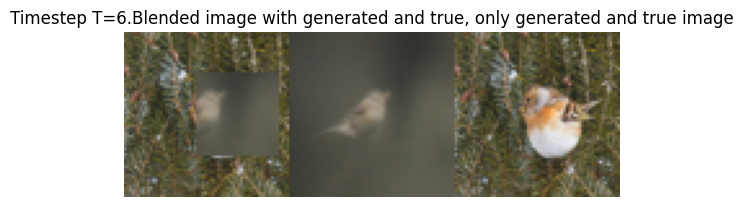

Timestep T=5


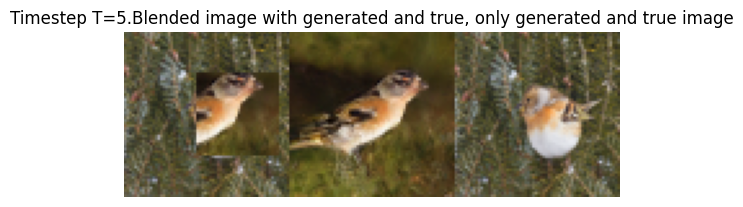

Timestep T=4


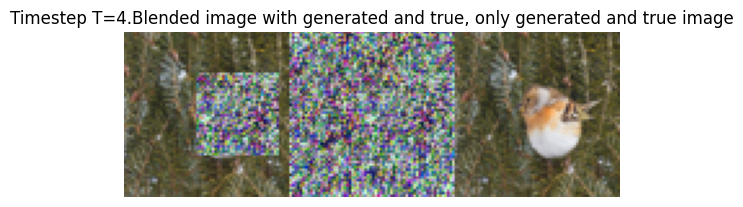

Timestep T=3


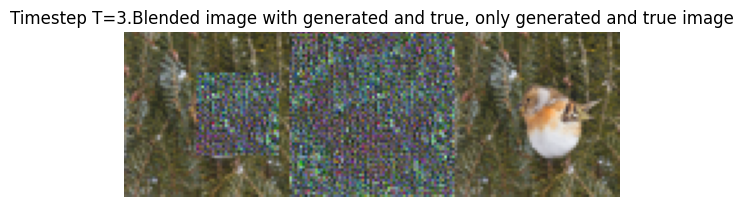

Timestep T=2


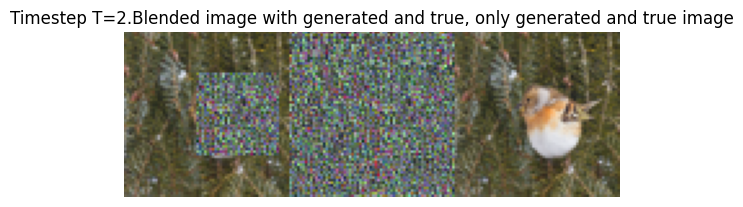

(tensor([[[[-1.1850e+02,  5.3131e+01, -6.5307e+01,  ..., -5.2130e+01,
             3.2885e+01,  4.9358e+01],
           [ 2.3105e+01,  7.5574e+01, -4.2692e+01,  ...,  5.8918e+01,
             6.3032e+01,  7.5650e+01],
           [ 8.0024e+01,  7.9431e+01,  4.1309e+01,  ...,  6.3679e+01,
            -3.9615e+01,  1.9790e+01],
           ...,
           [ 9.5230e+01, -4.0891e+01, -8.4731e+00,  ..., -3.3531e+01,
            -1.6220e+02,  1.8887e+01],
           [ 3.1018e+01, -6.9722e+00,  5.3130e+00,  ...,  3.5991e+01,
             9.6230e-01,  8.0294e+01],
           [ 7.7091e+01,  7.5827e+01,  1.6140e+01,  ...,  4.5199e+01,
            -7.6999e+01, -9.9742e+01]],
 
          [[ 4.6595e+01,  7.4479e+01, -1.0546e+02,  ...,  2.5950e+01,
            -7.8923e+01,  6.1366e+01],
           [ 3.0713e+01,  2.7513e+01, -2.2018e+02,  ..., -3.9043e+01,
            -5.3538e+01,  9.5510e+01],
           [ 6.4970e+01,  7.1255e+01, -8.9754e+01,  ..., -9.6031e+01,
            -4.3769e+01, -9.3068e+01],


In [29]:
ts = [i for i in range(10,0,-1)]
print(f"{ts=}")
iterative_inpainting(pipe=pipe, images=x_true,class_labels=10, is_imagenet=True,
x=x_true.clone(),
ts=ts, use_square_mask=True, show_all_modified_image=True)